In [1]:
import pandas as pd
import glob
import GPy
import GPyOpt
import numpy as np 
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import random
%matplotlib inline

import pandas as pd
pd.set_option('display.max_rows', 500)

In [2]:
path_list = glob.glob('./info_result/*')
df = pd.DataFrame(columns=['fileNumber', 'CENTER_RIGID_x', 'CENTER_RIGID_y', 'RIGID_ANGLE', 'DNS_RIGID'])
print(len(path_list))
isCollide = []
for result_file in path_list:
    df = pd.concat([df,pd.read_csv(result_file + '/prop.txt')])
    isCollide.append(pd.read_csv(result_file + '/Collision.csv').any().isCollide)
df.dropna(axis=1, inplace=True)
df.reset_index(inplace=True,drop=True)
df = pd.concat([df,pd.Series(isCollide,name='isCollide')],axis=1)
df.sort_values('fileNumber',inplace=True)
df.reset_index(inplace=True,drop=True)
df.columns = ['CENTER_RIGID_x', 'CENTER_RIGID_y', 'DNS_RIGID', 'RIGID_ANGLE','fileNumber', 'isCollide']

max_x = df.CENTER_RIGID_x.max()
min_x = df.CENTER_RIGID_x.min()
max_y = df.CENTER_RIGID_y.max()
min_y = df.CENTER_RIGID_y.min()

df = df.rename(columns={'CENTER_RIGID_x': 'x','CENTER_RIGID_y': 'y'})
df_700 = df[df.DNS_RIGID==700].reset_index(drop=True)
df_3500 = df[df.DNS_RIGID==3500].reset_index(drop=True)

df.head()

261


,x,y,DNS_RIGID,RIGID_ANGLE,fileNumber,isCollide
0,0.5,0.01,700.0,0.0,1,False
1,0.5,0.05,700.0,0.0,2,False
2,0.5,0.09,700.0,0.0,3,False
3,0.5,0.13,700.0,0.0,4,True
4,0.5,0.17,700.0,0.0,5,True


In [266]:
def sig(z):
    return 1/(1+np.exp(-z))

def train_test(df):
    yPoint = list(df.y.sort_values().unique())
    dropList = []
    for i in range(0,len(yPoint)):
        if(i%2==1):
            dropList.append(yPoint[i])
    #print(dropList)
    df_train = df[(df.y!=dropList[0])&(df.y!=dropList[1])&(df.y!=dropList[2])&(df.y!=dropList[3])&(df.y!=dropList[4])&(df.y!=dropList[5])&(df.y!=dropList[6])]
    df_test = df[(df.y==dropList[0])|(df.y==dropList[1])|(df.y==dropList[2])|(df.y==dropList[3])|(df.y==dropList[4])|(df.y==dropList[5])|(df.y==dropList[6])]
    return df_train.reset_index(drop=True), df_test.reset_index(drop=True)

def gp(data,kernel):
    #print(data.shape[0])
    model = GPy.models.GPClassification(data[['x', 'y']].values, (data.isCollide+1-1)[:, None],kernel=kernel)
    #model['.*Mat52.var'].constrain_fixed(1)
    model.optimize()#messages=True)
    return model

def mean_var(data, model):
    tmp = []
    for i in range(0,data.shape[0]):
        tmp.append([data.x[i:i+1].values[0],data.y[i:i+1].values[0]])
    res = pd.DataFrame(tmp,columns=['x','y'])
    res['latent_mean'] = pd.Series(model.predict_noiseless(np.array(tmp))[0][:,0])
    res['latent_var'] = pd.Series(model.predict_noiseless(np.array(tmp))[1][:,0])
    res['ave_mean'] = pd.Series(model.predict(np.array(tmp))[0][:,0])
    return res

# 要実装
def bo(data, model, aq='UCB'):
    #print(data)
    tmp = mean_var(data,model)
    if aq=='UCB':
        k = 1.0
        tmp['aq'] = tmp['latent_mean'] + k*tmp['latent_var']  # need k　要検証
        #idx = tmp['aq'].idxmax()
        idx = random.sample(np.where(tmp['aq'] == tmp['aq'].max()),1)[0][0]
    # maxmize
    elif aq=='LCB':
        k = 1.0
        tmp['aq'] = tmp['latent_mean'] - k*tmp['latent_var']  # need k　要検証
        idx = tmp['aq'].idxmix()
    elif aq=='EI':
        eps = 0.01
        # F+ どうすればよいのか？、そもそもvarのブレなさすぎでは？
        #tmp['aq'] = norm.cdf((tmp['latent_mean'] - max(tmp[])-eps)/tmp['latent_var'])
        idx = tmp['aq'].idxmax()
    elif ar=='PI':
        eps = 0.01
        tmp['aq'] = tmp['latent_mean'] + k*tmp['latent_var']
        idx = tmp['aq'].idxmax()
    
    x = tmp[idx:idx+1].x.values[0]
    y = tmp[idx:idx+1].y.values[0]
    res = data[(data.x==x) & (data.y==y)].index[0]
    return res 
    
def agg(test,model):
    # テストデータ正答率
    cnt = 0
    pred = mean_var(test, model)
    isfirst = True
    #print(pred)
    for i in range(0,pred.shape[0]):
        x = pred.x[i:i+1].values[0]
        y = pred.y[i:i+1].values[0]
        prob = sig(pred['latent_mean'][i:i+1].values[0])
        isCollide = True
        if prob<0.5:
            isCollide = False
        elif (prob==0.5) & isfirst:
            print('ちょうど0.5')
        tmp = test[(test.x==x)&(test.y==y)].reset_index(drop=True)
        if isCollide == tmp.isCollide[0]:
            cnt = cnt+1
        #else:
        #    print('Error:',tmp.x[0],tmp.y[0],prob)
        #if tmp.y[0]==0.19:
        #    print('Error:',tmp.x[0],tmp.y[0],prob)
    #print('正答率：', cnt/test.shape[0])
    return cnt/test.shape[0]
    
def cnt_plt(data,model,i):
    #print(data)
    ax = model.plot(plot_data=False, plot_limits=[[min_x*0.93,min_y-max_y*0.05],[max_x*1.03, max_y*1.05]],levels=49,plot_raw=True)
    d0 = data[data.isCollide == 0]
    d1 = data[data.isCollide == 1]
    ax.plot(d0.x, d0.y, 'bo')
    ax.plot(d1.x, d1.y, 'ro')
    ax.set_title('Posterior (iter='+str(i)+')')
    ax.set_xlabel("Center X of Rigid")
    ax.set_ylabel("Center Y of Rigid")
    #ax.set_xlim([min_x*1.05,max_x*1.03])
    #ax.set_ylim([min_y-max_y*0.05, max_y*1.05])
    plt.savefig('test_image/fig' + '{:0=3}'.format(i) + '.png')

def slice_x(model, fix_x, i, df_train=None):
    ax = model.plot(fixed_inputs=[(0, fix_x)], plot_data=False,plot_raw=True,apply_link=True)
    ax.set_title('X = ' + str(fix_x) + ' (iter='+ str(i)+')')
    ax.set_xlabel("Y")
    ax.set_ylabel('Probability')
    ax.set_xlim([0,0.3])
    ax.set_ylim([-0.04,1.02])
    plt.axhline(y=0.5, lw=1, color='black')   #色や太さ、線種も設定できる
    if fix_x==0.66:
        pred = mean_var(df_train, model)
        tt = pred[pred.x==0.66]
        plt.scatter(tt.y,tt['ave_mean'],c='blue', label='Train point')
        plt.legend()
        #from IPython.core.debugger import Pdb; Pdb().set_trace()
    plt.savefig('./test_image/slice_'+'{:0=3}'.format(i)+'.png')

In [267]:
def main(df,init_smpl,nloop,seed=0):#,kernel=GPy.kern.Matern52(2, ARD=True)):
    
    res = []
    fix_x = 0.66
    
    df_train, df_test = train_test(df)
    print('train : ', df_train.shape, ' test : ', df_test.shape)
    if df_train.shape[0]!=init_smpl+nloop:
        raise 
    
    # get init point
    random.seed(seed)
    smpl = random.sample(range(0,df_train.shape[0]),init_smpl) 

    for i in range(0,nloop):
        # data整形
        print('sampling : ', smpl)
        kernel=GPy.kern.Matern32(2, ARD=True)
        df_smpl = df_train.iloc[smpl,:].reset_index(drop=True)
        model = gp(df_smpl, kernel)
        nxt_point = bo(df_train.drop(smpl), model)
        smpl.append(nxt_point)
        print('next point : ', nxt_point)
        res.append([agg(df_train, model),agg(df_test, model)])
        cnt_plt(df_smpl,model,i)
        slice_x(model,fix_x,i,df)
        print('--------------------------------------------------------')
        del kernel
        del df_smpl
        del model
    
    # 最後一回
    smpl.append(nxt_point)
    kernel=GPy.kern.Matern32(2, ARD=True)
    print('sampling : ', smpl)
    df_smpl = df_train.iloc[smpl,:].reset_index(drop=True)
    model = gp(df_smpl, kernel)
    res.append([agg(df_train, model),agg(df_test, model)])
    cnt_plt(df_smpl,model,i+1)
    slice_x(model,fix_x,i+1,df)
    
    #plt.plot(res)
    #plt.title('Prediction Accuracy')
    #plt.xlabel('Iteration')
    #plt.ylabel('Accuracy')
    #plt.savefig('./test_image/Prediction Accuracy.png')

    return model, res

train :  (136, 6)  test :  (112, 6)
sampling :  [34, 16, 65, 30, 126, 115, 120, 97, 53, 12, 62, 3, 114, 106, 49, 55, 77, 128, 98, 0, 89, 57, 135, 92, 102, 29, 75, 13, 40, 124, 2, 122, 83, 69, 1, 48, 87, 27, 54, 112, 104, 67, 28, 56, 63, 70, 110, 44, 130, 86, 93, 58, 37, 105, 127, 71, 131, 23, 103, 15, 42, 64, 118, 74, 24, 38, 36, 91, 72, 50, 4, 61, 31, 47, 51, 25, 26, 109, 11, 78, 35, 88, 121, 43, 125, 96, 5, 85, 84, 32, 6, 10, 33, 60, 66, 68, 101, 132, 82, 19, 94, 73, 113, 46, 14, 116, 80, 45, 17, 117, 7, 79, 134, 123, 18, 22, 107, 8, 59, 90, 99, 76, 108, 20, 21, 119, 111, 9, 95, 129, 41, 100, 52]
next point :  133
--------------------------------------------------------
sampling :  [34, 16, 65, 30, 126, 115, 120, 97, 53, 12, 62, 3, 114, 106, 49, 55, 77, 128, 98, 0, 89, 57, 135, 92, 102, 29, 75, 13, 40, 124, 2, 122, 83, 69, 1, 48, 87, 27, 54, 112, 104, 67, 28, 56, 63, 70, 110, 44, 130, 86, 93, 58, 37, 105, 127, 71, 131, 23, 103, 15, 42, 64, 118, 74, 24, 38, 36, 91, 72, 50, 4, 61, 31, 

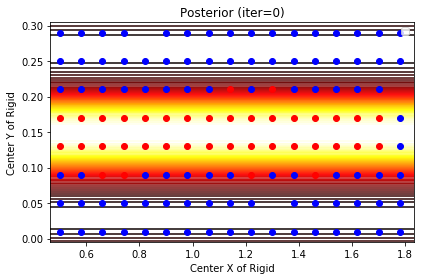

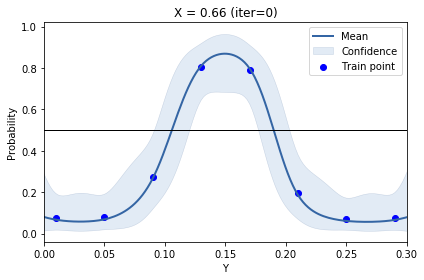

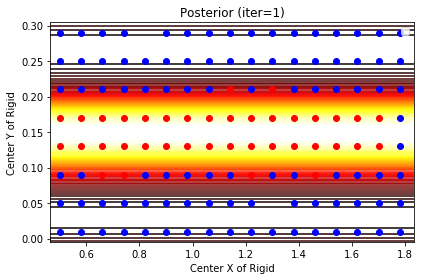

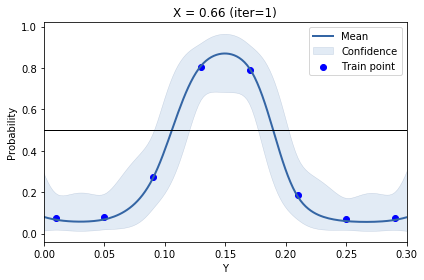

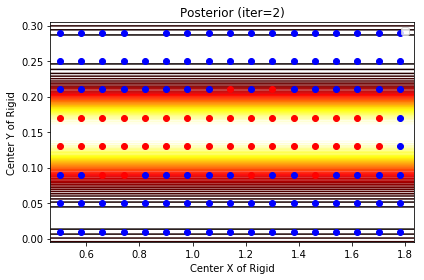

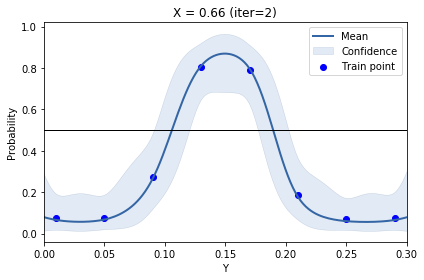

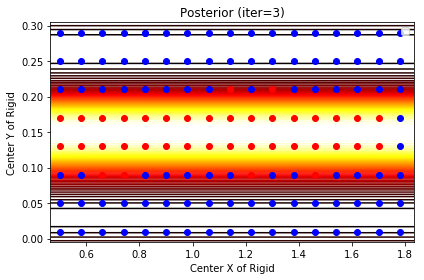

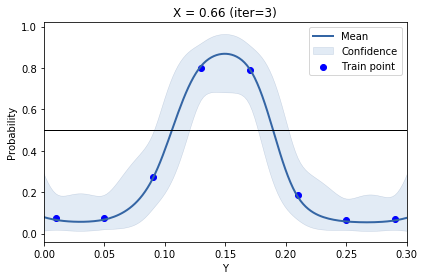

In [253]:
i=3
model, res = main(df_700,136-i,i,seed=1)#, kernel=GPy.kern.Matern32(2, ARD=True)+GPy.kern.White(2))

train :  (136, 6)  test :  (112, 6)
sampling :  [34, 16, 65, 30, 126, 115, 120, 97, 53, 24]
next point :  135
--------------------------------------------------------
sampling :  [34, 16, 65, 30, 126, 115, 120, 97, 53, 24, 135]
next point :  134
--------------------------------------------------------
sampling :  [34, 16, 65, 30, 126, 115, 120, 97, 53, 24, 135, 134]
next point :  128
--------------------------------------------------------
sampling :  [34, 16, 65, 30, 126, 115, 120, 97, 53, 24, 135, 134, 128]
next point :  133
--------------------------------------------------------
sampling :  [34, 16, 65, 30, 126, 115, 120, 97, 53, 24, 135, 134, 128, 133]
next point :  129
--------------------------------------------------------
sampling :  [34, 16, 65, 30, 126, 115, 120, 97, 53, 24, 135, 134, 128, 133, 129]
next point :  7
--------------------------------------------------------
sampling :  [34, 16, 65, 30, 126, 115, 120, 97, 53, 24, 135, 134, 128, 133, 129, 7]
next point :  130
---

--------------------------------------------------------
sampling :  [34, 16, 65, 30, 126, 115, 120, 97, 53, 24, 135, 134, 128, 133, 129, 7, 130, 132, 0, 131, 127, 6, 121, 125, 122, 1, 124, 123, 119, 112, 118, 113, 117, 114, 116, 111, 104, 110, 105, 109, 108, 107, 106, 103, 96, 102, 101, 98]
next point :  99
--------------------------------------------------------
sampling :  [34, 16, 65, 30, 126, 115, 120, 97, 53, 24, 135, 134, 128, 133, 129, 7, 130, 132, 0, 131, 127, 6, 121, 125, 122, 1, 124, 123, 119, 112, 118, 113, 117, 114, 116, 111, 104, 110, 105, 109, 108, 107, 106, 103, 96, 102, 101, 98, 99]
next point :  100
--------------------------------------------------------
sampling :  [34, 16, 65, 30, 126, 115, 120, 97, 53, 24, 135, 134, 128, 133, 129, 7, 130, 132, 0, 131, 127, 6, 121, 125, 122, 1, 124, 123, 119, 112, 118, 113, 117, 114, 116, 111, 104, 110, 105, 109, 108, 107, 106, 103, 96, 102, 101, 98, 99, 100]
next point :  88
--------------------------------------------------------

--------------------------------------------------------
sampling :  [34, 16, 65, 30, 126, 115, 120, 97, 53, 24, 135, 134, 128, 133, 129, 7, 130, 132, 0, 131, 127, 6, 121, 125, 122, 1, 124, 123, 119, 112, 118, 113, 117, 114, 116, 111, 104, 110, 105, 109, 108, 107, 106, 103, 96, 102, 101, 98, 99, 100, 88, 95, 3, 2, 5, 89, 94, 90, 93, 91, 80, 92, 87, 8, 11, 4, 15, 9, 14, 10, 13, 12]
next point :  23
--------------------------------------------------------
sampling :  [34, 16, 65, 30, 126, 115, 120, 97, 53, 24, 135, 134, 128, 133, 129, 7, 130, 132, 0, 131, 127, 6, 121, 125, 122, 1, 124, 123, 119, 112, 118, 113, 117, 114, 116, 111, 104, 110, 105, 109, 108, 107, 106, 103, 96, 102, 101, 98, 99, 100, 88, 95, 3, 2, 5, 89, 94, 90, 93, 91, 80, 92, 87, 8, 11, 4, 15, 9, 14, 10, 13, 12, 23]
next point :  17
--------------------------------------------------------
sampling :  [34, 16, 65, 30, 126, 115, 120, 97, 53, 24, 135, 134, 128, 133, 129, 7, 130, 132, 0, 131, 127, 6, 121, 125, 122, 1, 124, 123,

next point :  83
--------------------------------------------------------
sampling :  [34, 16, 65, 30, 126, 115, 120, 97, 53, 24, 135, 134, 128, 133, 129, 7, 130, 132, 0, 131, 127, 6, 121, 125, 122, 1, 124, 123, 119, 112, 118, 113, 117, 114, 116, 111, 104, 110, 105, 109, 108, 107, 106, 103, 96, 102, 101, 98, 99, 100, 88, 95, 3, 2, 5, 89, 94, 90, 93, 91, 80, 92, 87, 8, 11, 4, 15, 9, 14, 10, 13, 12, 23, 17, 22, 32, 21, 18, 19, 20, 25, 31, 26, 27, 35, 43, 51, 59, 67, 75, 83]
next point :  28
--------------------------------------------------------
sampling :  [34, 16, 65, 30, 126, 115, 120, 97, 53, 24, 135, 134, 128, 133, 129, 7, 130, 132, 0, 131, 127, 6, 121, 125, 122, 1, 124, 123, 119, 112, 118, 113, 117, 114, 116, 111, 104, 110, 105, 109, 108, 107, 106, 103, 96, 102, 101, 98, 99, 100, 88, 95, 3, 2, 5, 89, 94, 90, 93, 91, 80, 92, 87, 8, 11, 4, 15, 9, 14, 10, 13, 12, 23, 17, 22, 32, 21, 18, 19, 20, 25, 31, 26, 27, 35, 43, 51, 59, 67, 75, 83, 28]
next point :  36
-------------------------

next point :  74
--------------------------------------------------------
sampling :  [34, 16, 65, 30, 126, 115, 120, 97, 53, 24, 135, 134, 128, 133, 129, 7, 130, 132, 0, 131, 127, 6, 121, 125, 122, 1, 124, 123, 119, 112, 118, 113, 117, 114, 116, 111, 104, 110, 105, 109, 108, 107, 106, 103, 96, 102, 101, 98, 99, 100, 88, 95, 3, 2, 5, 89, 94, 90, 93, 91, 80, 92, 87, 8, 11, 4, 15, 9, 14, 10, 13, 12, 23, 17, 22, 32, 21, 18, 19, 20, 25, 31, 26, 27, 35, 43, 51, 59, 67, 75, 83, 28, 36, 44, 52, 60, 68, 76, 84, 42, 50, 58, 66, 74]
next point :  82
--------------------------------------------------------
sampling :  [34, 16, 65, 30, 126, 115, 120, 97, 53, 24, 135, 134, 128, 133, 129, 7, 130, 132, 0, 131, 127, 6, 121, 125, 122, 1, 124, 123, 119, 112, 118, 113, 117, 114, 116, 111, 104, 110, 105, 109, 108, 107, 106, 103, 96, 102, 101, 98, 99, 100, 88, 95, 3, 2, 5, 89, 94, 90, 93, 91, 80, 92, 87, 8, 11, 4, 15, 9, 14, 10, 13, 12, 23, 17, 22, 32, 21, 18, 19, 20, 25, 31, 26, 27, 35, 43, 51, 59, 67, 75

next point :  56
--------------------------------------------------------
sampling :  [34, 16, 65, 30, 126, 115, 120, 97, 53, 24, 135, 134, 128, 133, 129, 7, 130, 132, 0, 131, 127, 6, 121, 125, 122, 1, 124, 123, 119, 112, 118, 113, 117, 114, 116, 111, 104, 110, 105, 109, 108, 107, 106, 103, 96, 102, 101, 98, 99, 100, 88, 95, 3, 2, 5, 89, 94, 90, 93, 91, 80, 92, 87, 8, 11, 4, 15, 9, 14, 10, 13, 12, 23, 17, 22, 32, 21, 18, 19, 20, 25, 31, 26, 27, 35, 43, 51, 59, 67, 75, 83, 28, 36, 44, 52, 60, 68, 76, 84, 42, 50, 58, 66, 74, 82, 29, 37, 45, 61, 69, 77, 85, 39, 40, 47, 48, 55, 33, 56]
next point :  63
--------------------------------------------------------
sampling :  [34, 16, 65, 30, 126, 115, 120, 97, 53, 24, 135, 134, 128, 133, 129, 7, 130, 132, 0, 131, 127, 6, 121, 125, 122, 1, 124, 123, 119, 112, 118, 113, 117, 114, 116, 111, 104, 110, 105, 109, 108, 107, 106, 103, 96, 102, 101, 98, 99, 100, 88, 95, 3, 2, 5, 89, 94, 90, 93, 91, 80, 92, 87, 8, 11, 4, 15, 9, 14, 10, 13, 12, 23, 17, 22

next point :  62
--------------------------------------------------------
sampling :  [34, 16, 65, 30, 126, 115, 120, 97, 53, 24, 135, 134, 128, 133, 129, 7, 130, 132, 0, 131, 127, 6, 121, 125, 122, 1, 124, 123, 119, 112, 118, 113, 117, 114, 116, 111, 104, 110, 105, 109, 108, 107, 106, 103, 96, 102, 101, 98, 99, 100, 88, 95, 3, 2, 5, 89, 94, 90, 93, 91, 80, 92, 87, 8, 11, 4, 15, 9, 14, 10, 13, 12, 23, 17, 22, 32, 21, 18, 19, 20, 25, 31, 26, 27, 35, 43, 51, 59, 67, 75, 83, 28, 36, 44, 52, 60, 68, 76, 84, 42, 50, 58, 66, 74, 82, 29, 37, 45, 61, 69, 77, 85, 39, 40, 47, 48, 55, 33, 56, 63, 41, 71, 49, 64, 79, 57, 73, 81, 72, 38, 46, 54, 62]
next point :  70
--------------------------------------------------------
sampling :  [34, 16, 65, 30, 126, 115, 120, 97, 53, 24, 135, 134, 128, 133, 129, 7, 130, 132, 0, 131, 127, 6, 121, 125, 122, 1, 124, 123, 119, 112, 118, 113, 117, 114, 116, 111, 104, 110, 105, 109, 108, 107, 106, 103, 96, 102, 101, 98, 99, 100, 88, 95, 3, 2, 5, 89, 94, 90, 93, 91,

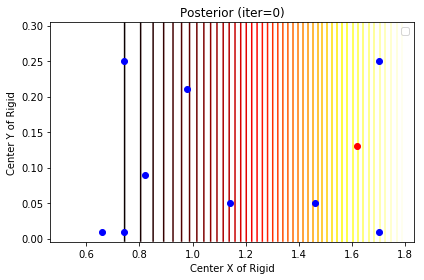

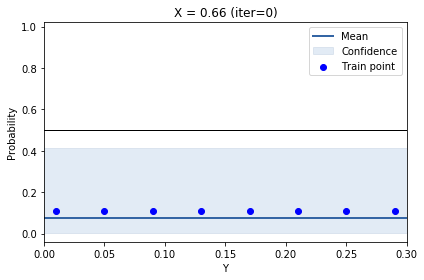

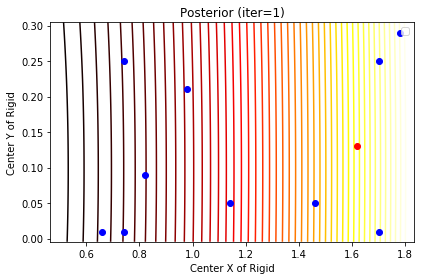

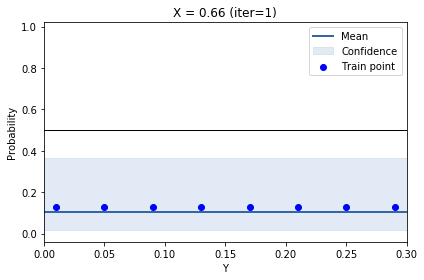

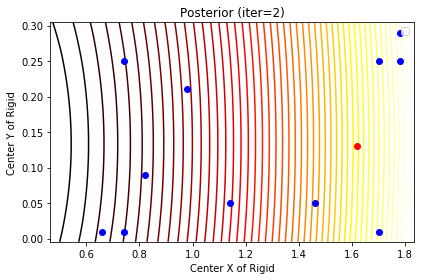

...

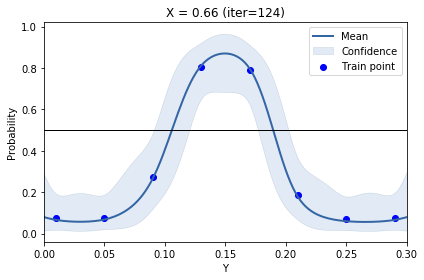

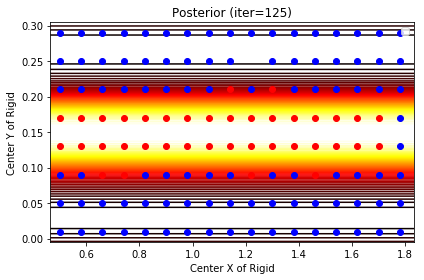

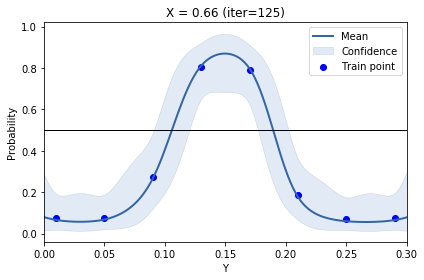

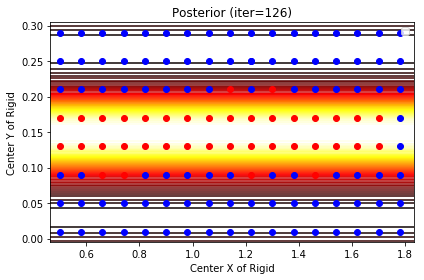

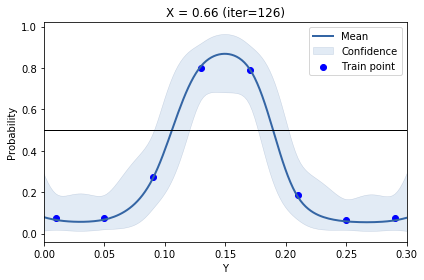

In [272]:
i=126
model, res = main(df_700,136-i,i,seed=1)#, kernel=GPy.kern.Matern32(2, ARD=True)+GPy.kern.White(2))

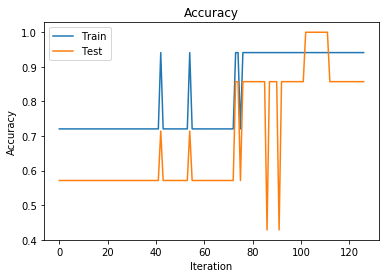

In [271]:
fig = plt.figure()
ax = fig.add_subplot(1,1,1)

ax.plot(range(0,len(res)),np.array(res).transpose()[0], label='Train')
ax.plot(range(0,len(res)),np.array(res).transpose()[1], label='Test')

ax.set_title('Accuracy')
ax.set_xlabel('Iteration')
ax.set_ylabel('Accuracy')
ax.legend()
plt.savefig('./test_image/Accuracy.png')

In [259]:
df_train, df_test = train_test(df)
aggDBG(df_test, model)

Error: 0.54 0.19 0.49378077464963
Error: 0.62 0.19 0.4937807624105283
Error: 0.7 0.19 0.4937807500944414
Error: 0.78 0.19 0.49378073770137226
Error: 0.86 0.19 0.49378072523131633
Error: 0.94 0.19 0.4937807126842725
Error: 1.02 0.19 0.49378070006024977
Error: 1.1 0.19 0.4937806873592403
Error: 1.18 0.19 0.49378067458124725
Error: 1.26 0.19 0.49378066172626983
Error: 1.34 0.19 0.4937806487943099
Error: 1.42 0.19 0.49378063578536685
Error: 1.5 0.19 0.4937806226994394
Error: 1.58 0.19 0.49378060953652725
Error: 1.66 0.19 0.4937805962966348
Error: 1.74 0.19 0.4937805829797572


0.8571428571428571

In [258]:
def aggDBG(test,model):
    # テストデータ正答率
    cnt = 0
    pred = mean_var(test, model)
    isfirst = True
    #print(pred)
    for i in range(0,pred.shape[0]):
        x = pred.x[i:i+1].values[0]
        y = pred.y[i:i+1].values[0]
        prob = sig(pred['latent_mean'][i:i+1].values[0])
        isCollide = True
        if prob<0.5:
            isCollide = False
        elif (prob==0.5) & isfirst:
            print('ちょうど0.5')
        tmp = test[(test.x==x)&(test.y==y)].reset_index(drop=True)
        if isCollide == tmp.isCollide[0]:
            cnt = cnt+1
        else:
            print('Error:',tmp.x[0],tmp.y[0],prob)
        #if tmp.y[0]==0.19:
        #    print('Error:',tmp.x[0],tmp.y[0],prob)
    #print('正答率：', cnt/test.shape[0])
    return cnt/test.shape[0]

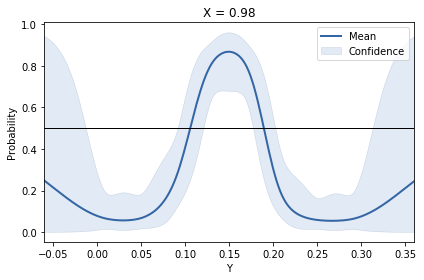

In [187]:
# defalt : lower=2.5, upper=97.5 
ax = model.plot(fixed_inputs=[(0, 0.98)], plot_data=False,plot_raw=True,apply_link=True)
ax.set_title('X = 0.98')
ax.set_xlabel("Y")
ax.set_ylabel("Probability")
#ax.set_xlim([0,0.3])
plt.axhline(y=0.5, lw=1, color='black')   #色や太さ、線種も設定できる

In [30]:
chk = [34, 16, 65, 30, 126, 115, 120, 97, 53, 12, 62, 3, 114, 106, 49, 55, 77, 128, 98, 0, 89, 57, 135, 92, 102, 29, 75, 13, 40, 124, 2, 122, 83, 69, 1, 48, 87, 27, 54, 112, 104, 67, 28, 56, 63, 70, 110, 44, 130, 86, 93, 58, 37, 105, 127, 71, 131, 23, 103, 15, 42, 64, 118, 74, 24, 38, 36, 91, 72, 50, 4, 61, 31, 47, 51, 25, 26, 109, 11, 78, 35, 88, 121, 43, 125, 96, 5, 85, 84, 32, 6, 10, 33, 60, 66, 68, 101, 132, 82, 19, 94, 73, 113, 46, 14, 116, 80, 45, 17, 117, 7, 79, 134, 123, 18, 22, 107, 8, 59, 90, 99, 76, 108, 20, 21, 119, 111, 9, 95, 129, 41, 100, 52, 133, 81, 39]

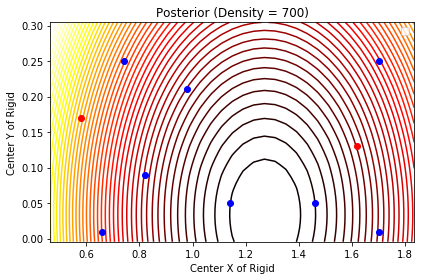

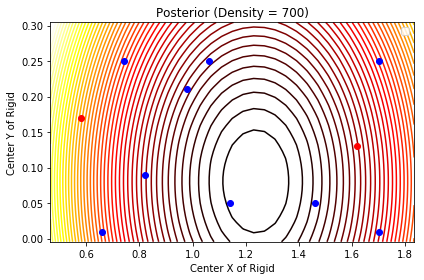

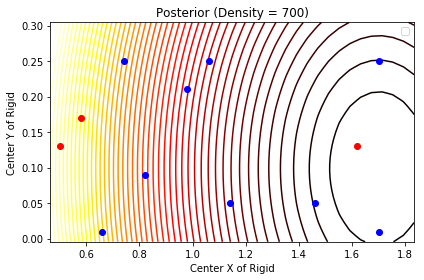

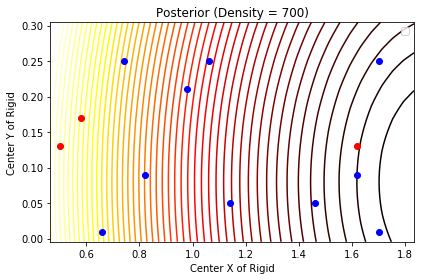

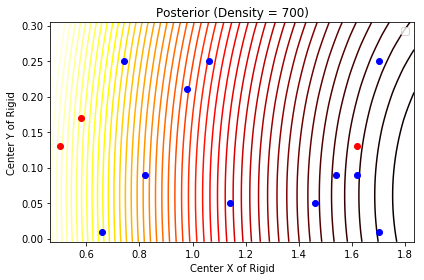

...

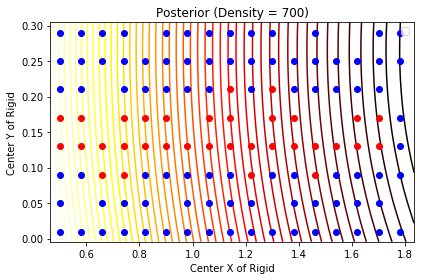

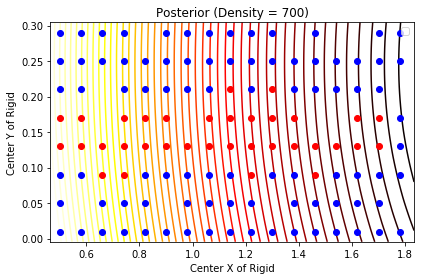

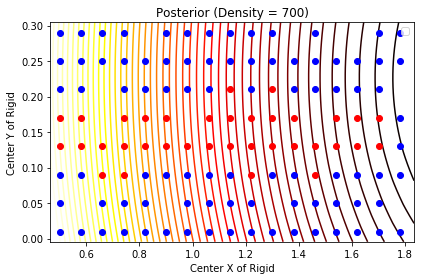

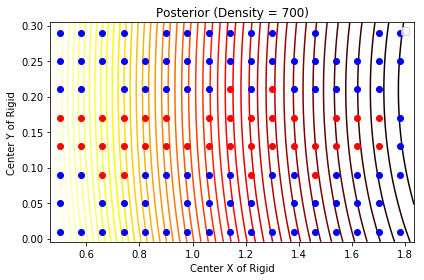

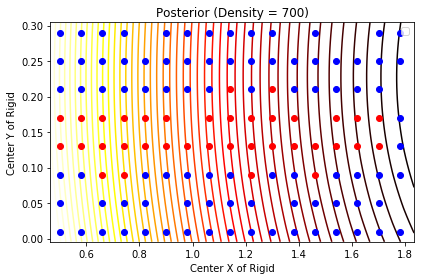

In [35]:
df_train, df_test = train_test(df)
kernel = GPy.kern.Matern32(2, ARD=True)
for i in range(0,116):
    df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
    model = gp(df_smpl, kernel)
    #res.append(agg(df_test, model))
    cnt_plt(df_smpl,model,0)

In [38]:
df_train, df_test = train_test(df)
i=0

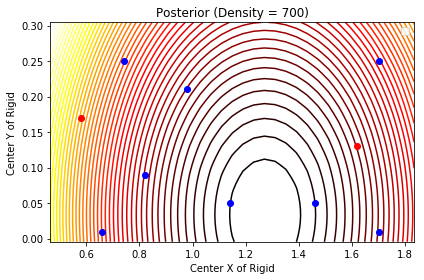

In [39]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

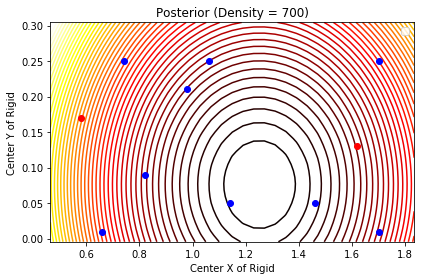

In [40]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

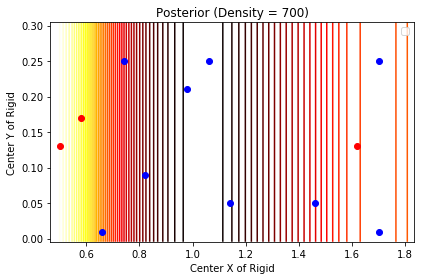

In [41]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

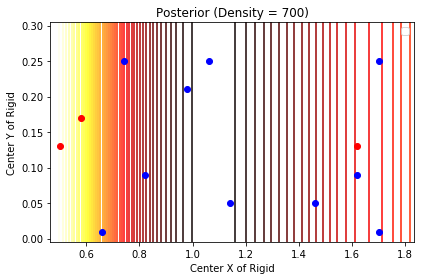

In [42]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

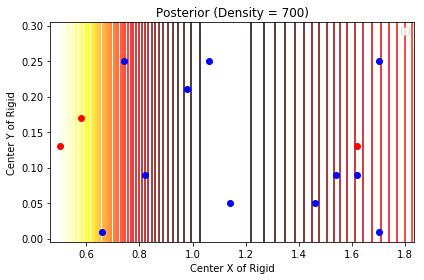

In [43]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

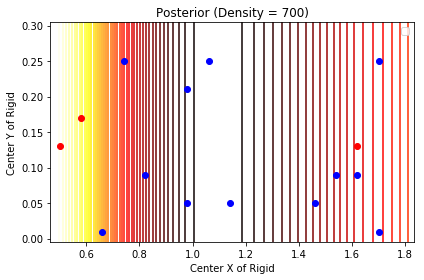

In [44]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

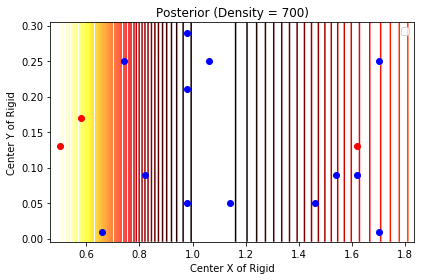

In [45]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

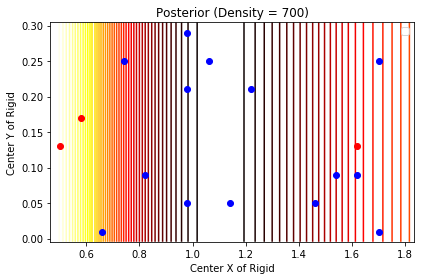

In [46]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

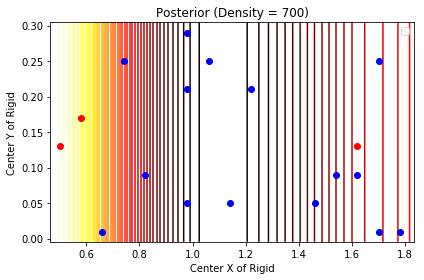

In [47]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

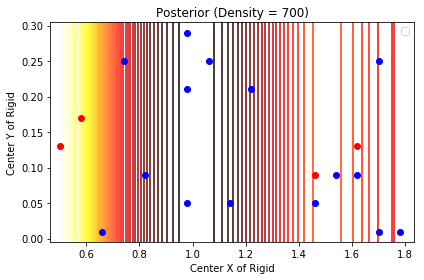

In [48]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

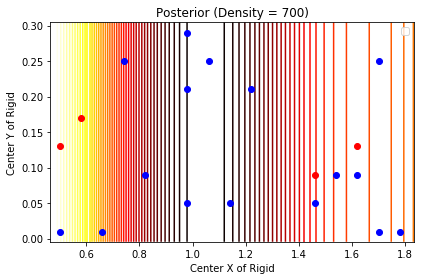

In [49]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

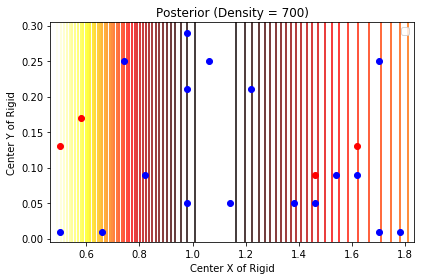

In [50]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

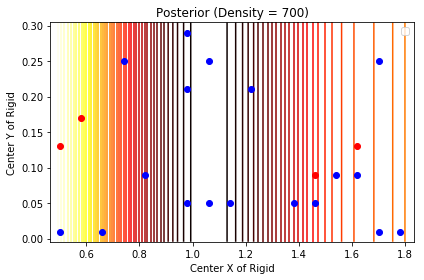

In [51]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

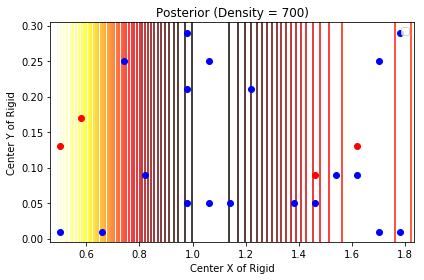

In [52]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

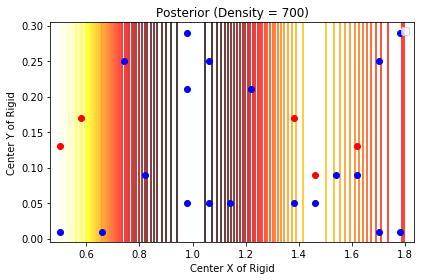

In [53]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

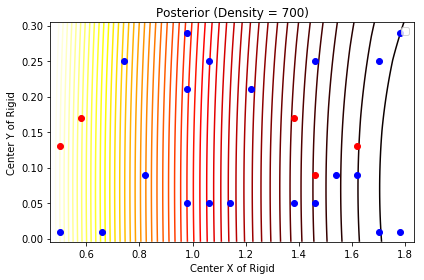

In [54]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

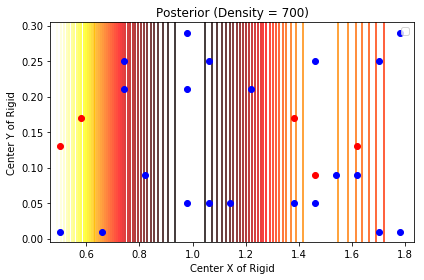

In [55]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

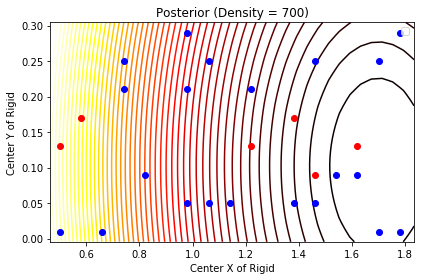

In [56]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

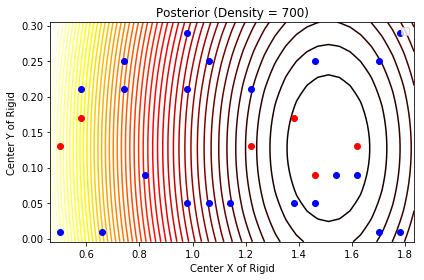

In [57]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

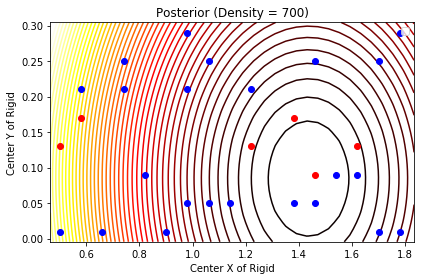

In [58]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

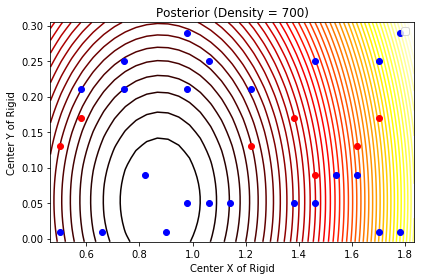

In [59]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

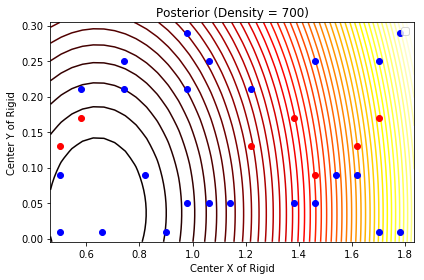

In [60]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

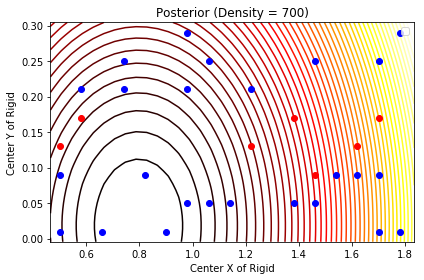

In [61]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

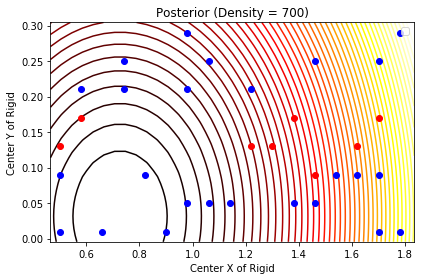

In [62]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

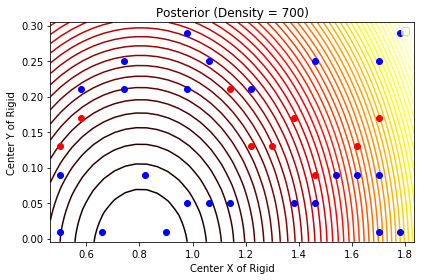

In [63]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

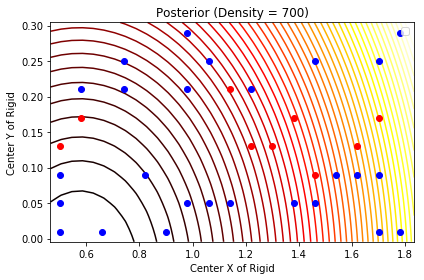

In [64]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

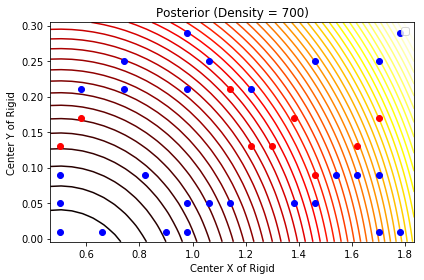

In [65]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

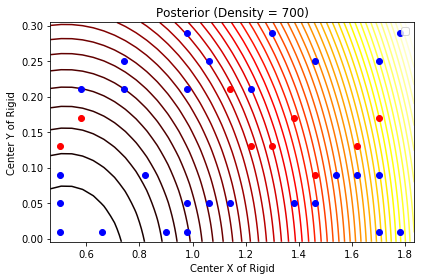

In [66]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

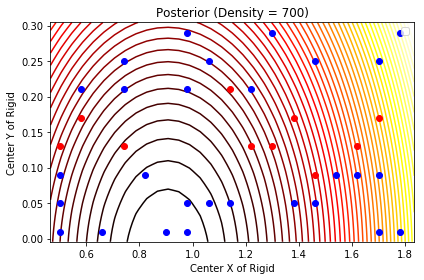

In [67]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

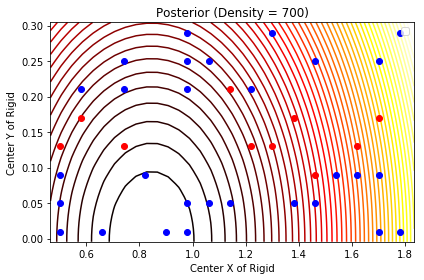

In [68]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

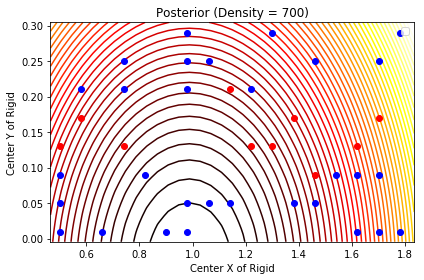

In [69]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

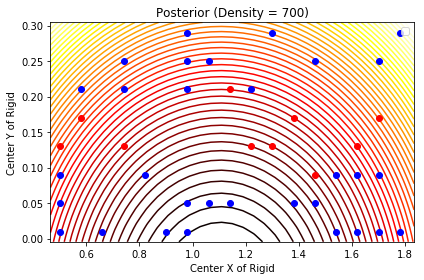

In [70]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

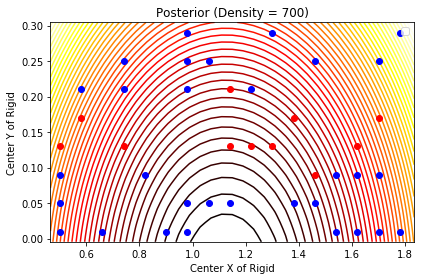

In [71]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

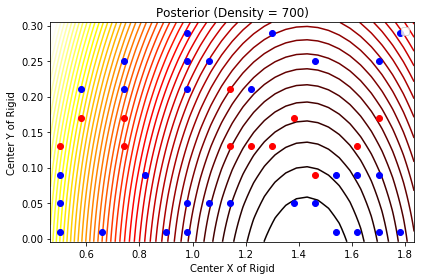

In [72]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

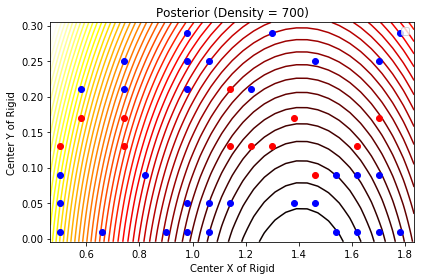

In [73]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

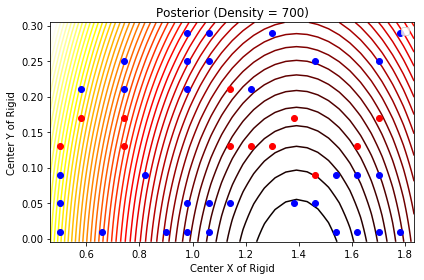

In [74]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

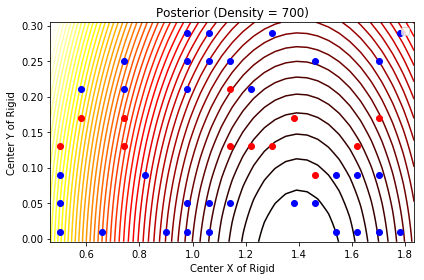

In [75]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

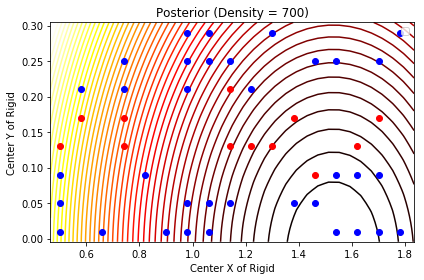

In [76]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

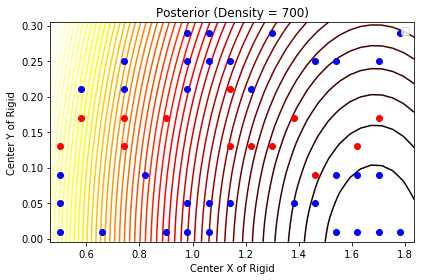

In [77]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

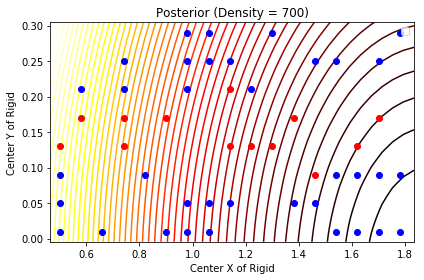

In [78]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

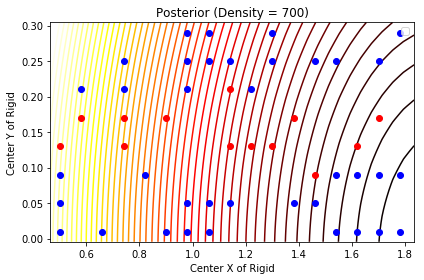

In [79]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

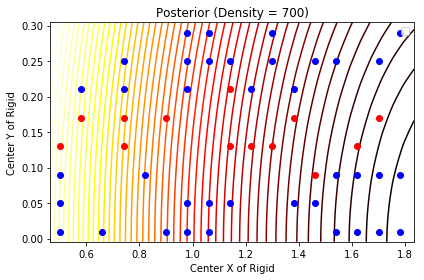

In [80]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

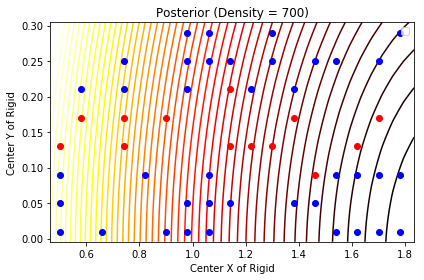

In [81]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

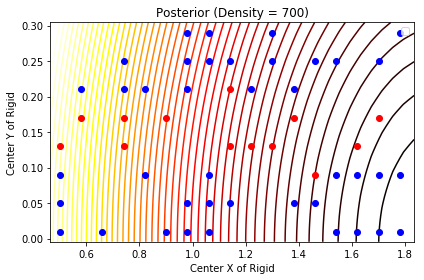

In [82]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

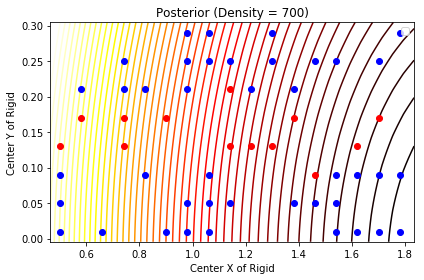

In [83]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

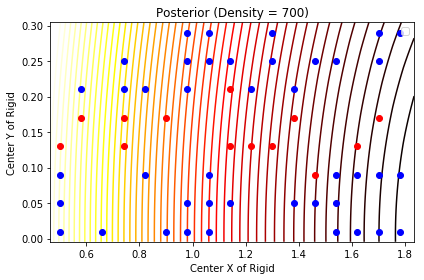

In [84]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

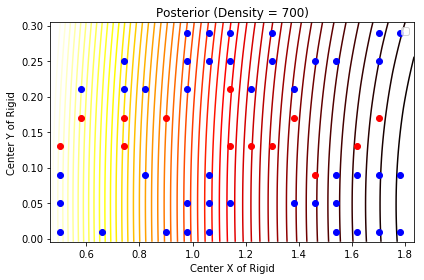

In [85]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

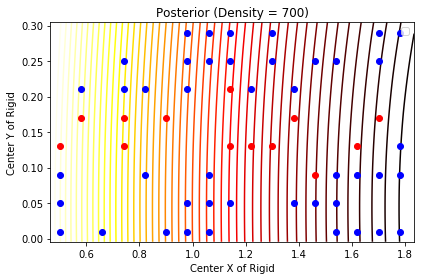

In [86]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

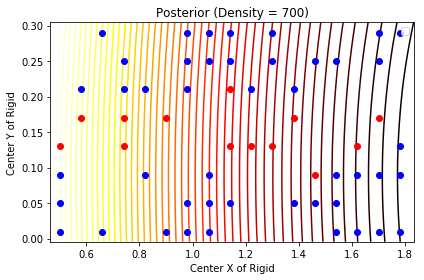

In [87]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

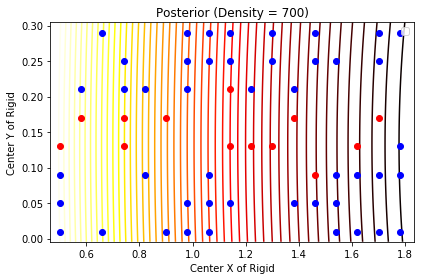

In [88]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

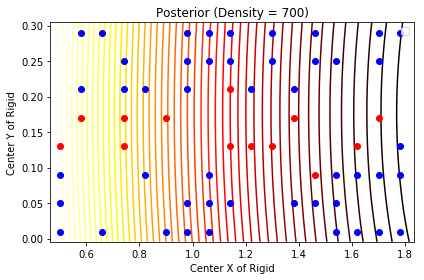

In [89]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

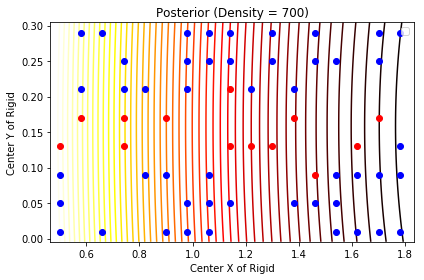

In [90]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

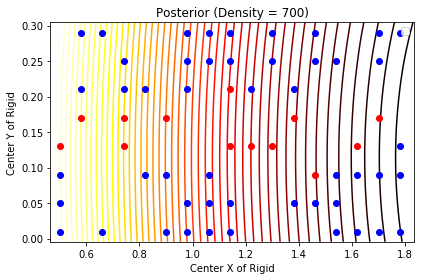

In [91]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

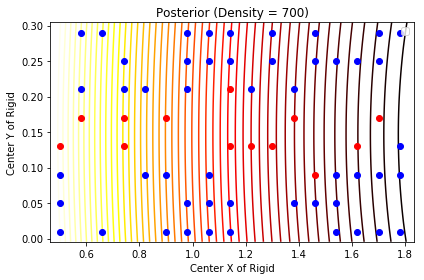

In [92]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

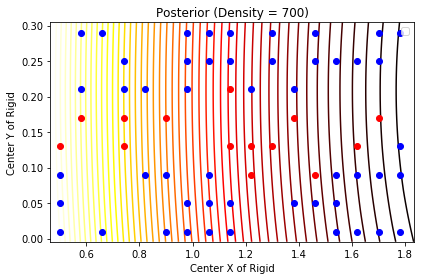

In [93]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

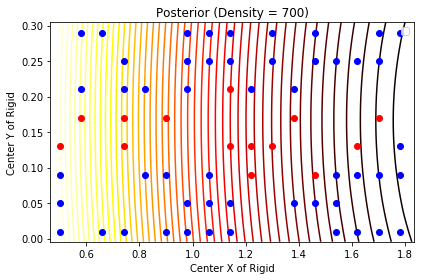

In [94]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

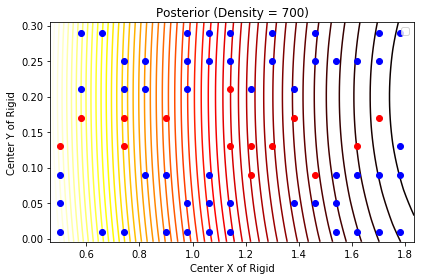

In [95]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

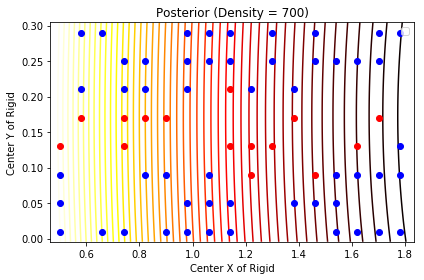

In [96]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

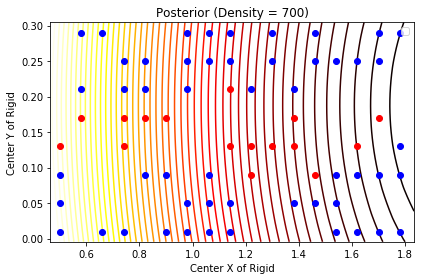

In [97]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

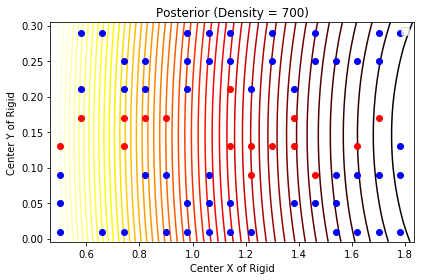

In [98]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

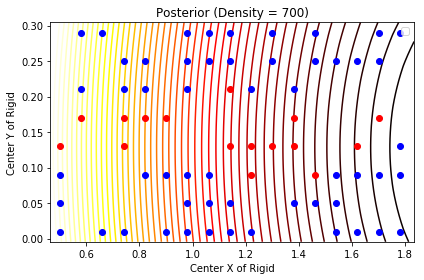

In [99]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

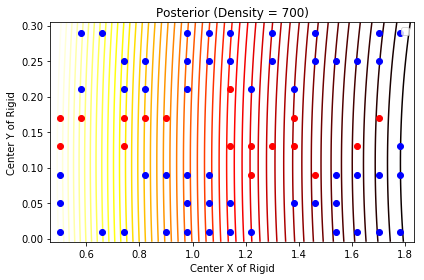

In [100]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

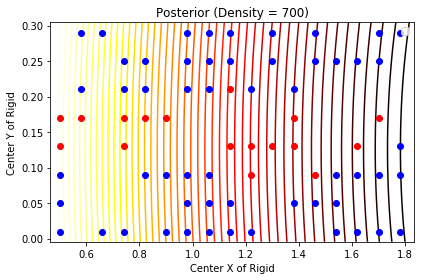

In [101]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

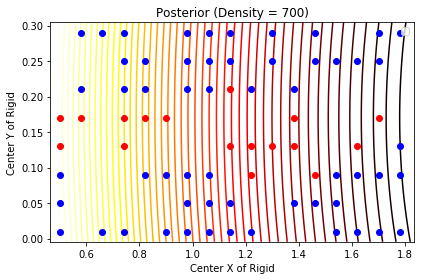

In [102]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

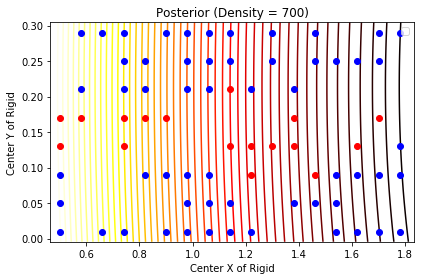

In [103]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

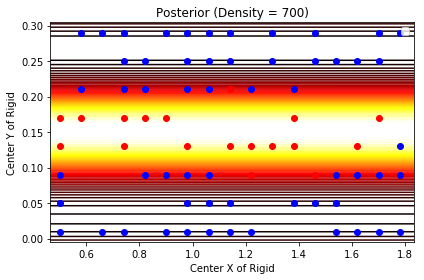

In [104]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

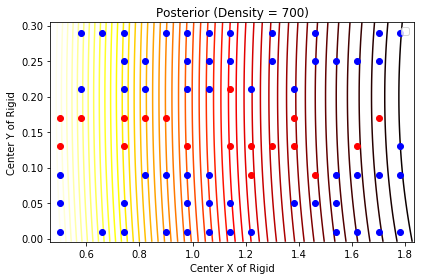

In [105]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

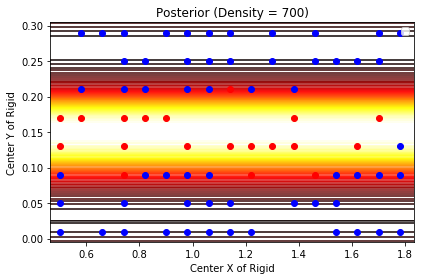

In [106]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

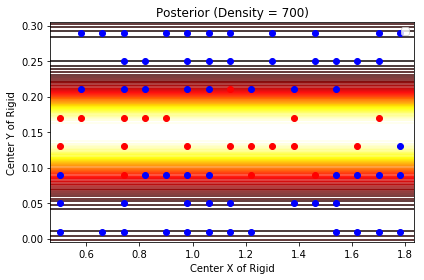

In [107]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5


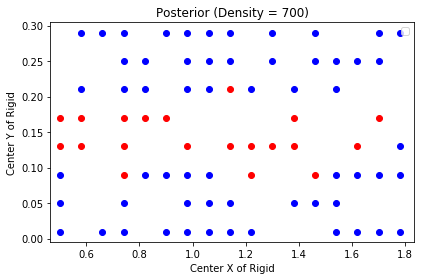

In [108]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

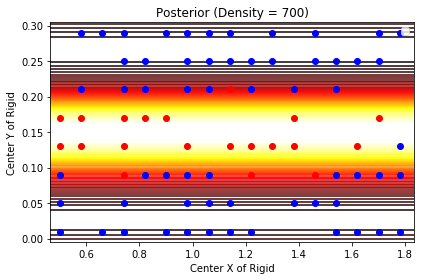

In [109]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

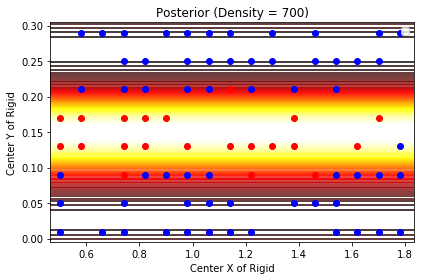

In [110]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

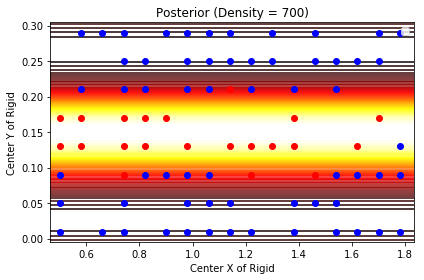

In [111]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

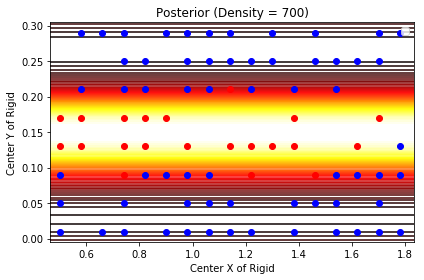

In [112]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

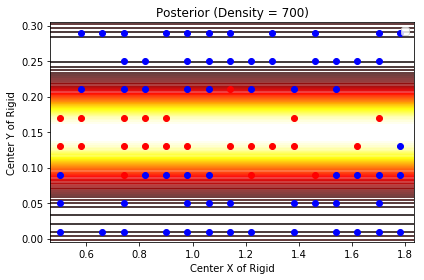

In [113]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

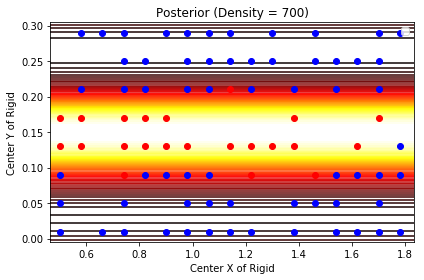

In [114]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

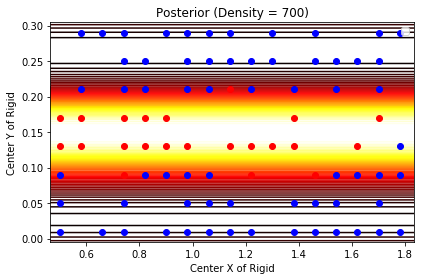

In [115]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

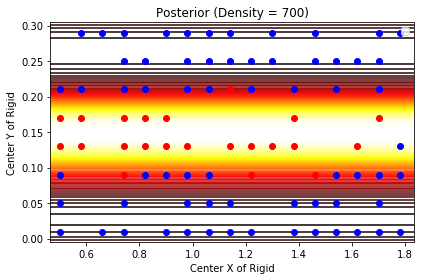

In [116]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

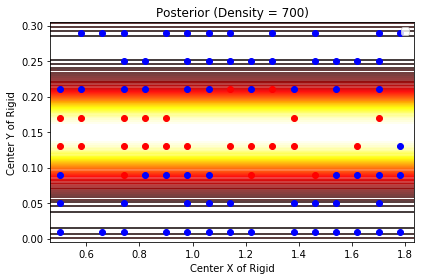

In [117]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

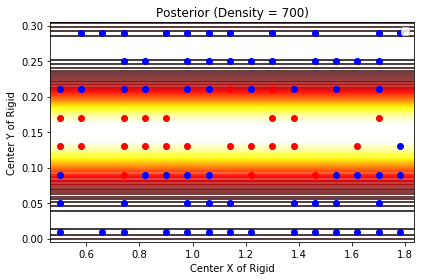

In [118]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

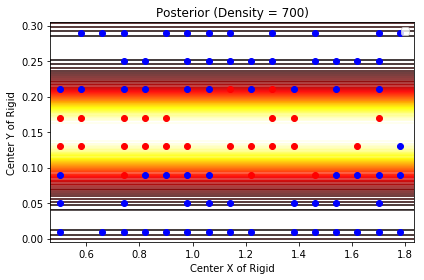

In [119]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

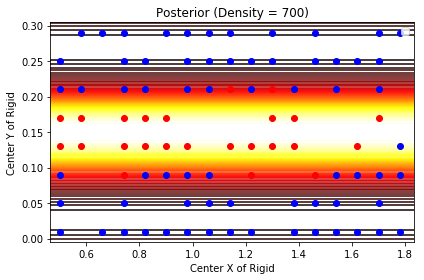

In [120]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

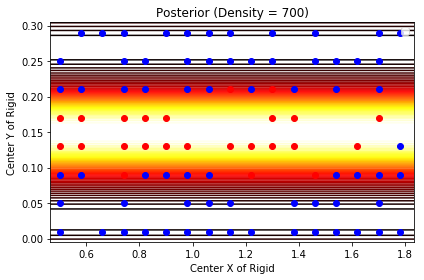

In [121]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

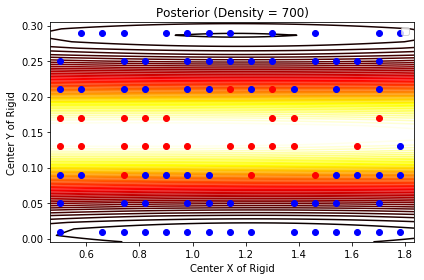

In [122]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

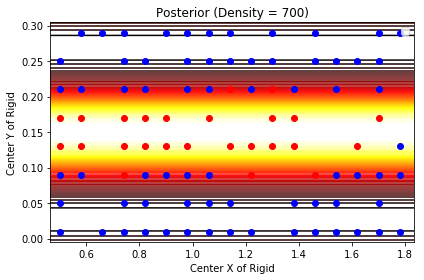

In [123]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

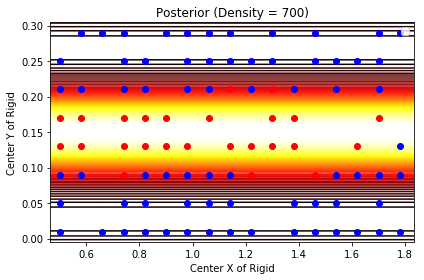

In [124]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5


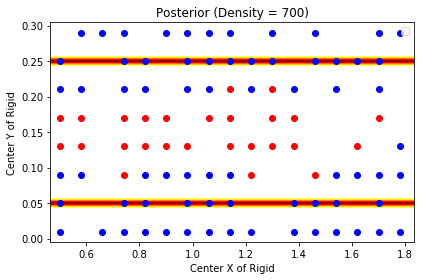

In [125]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

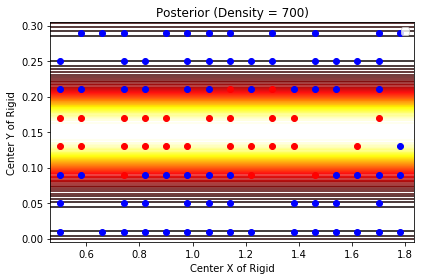

In [126]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5


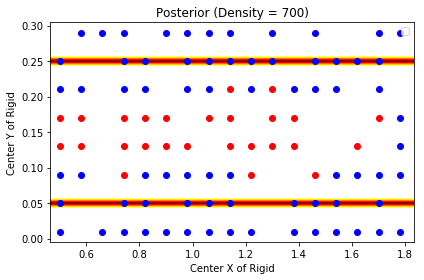

In [127]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

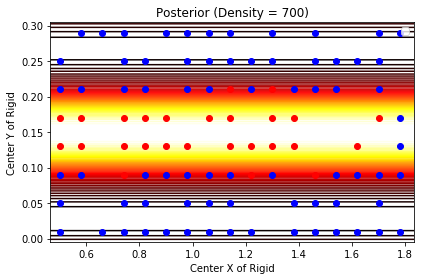

In [128]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

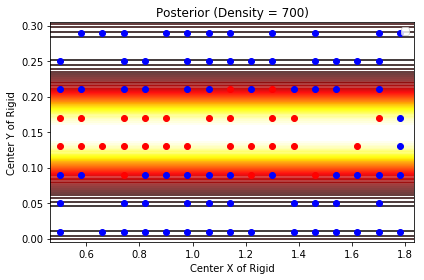

In [129]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

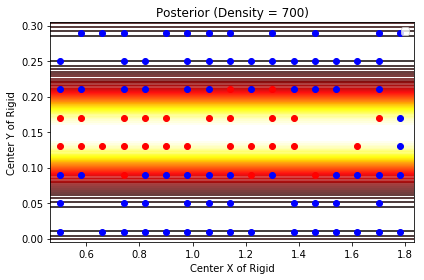

In [130]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

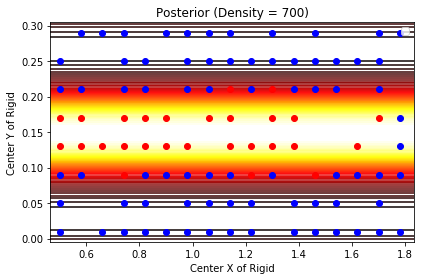

In [131]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

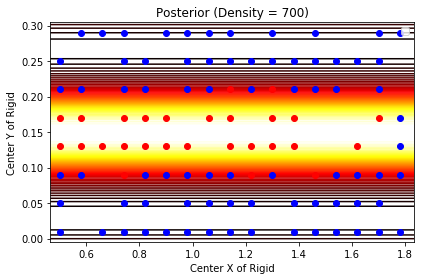

In [132]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

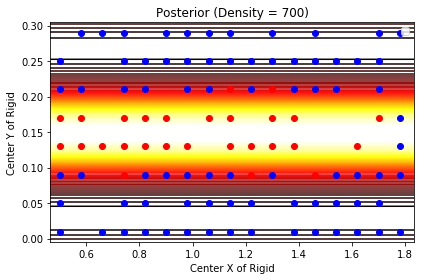

In [133]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

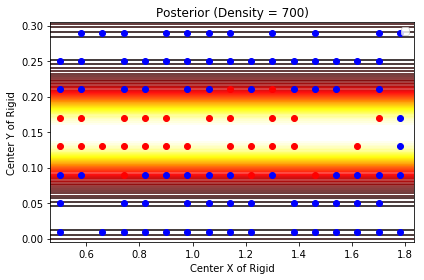

In [134]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

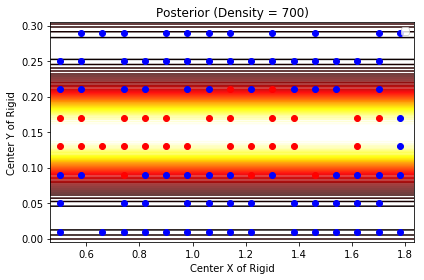

In [135]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

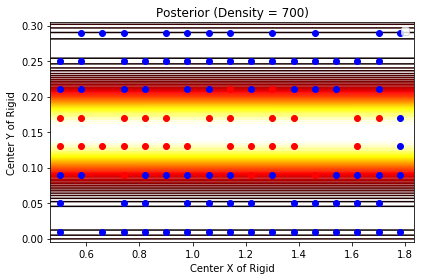

In [136]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

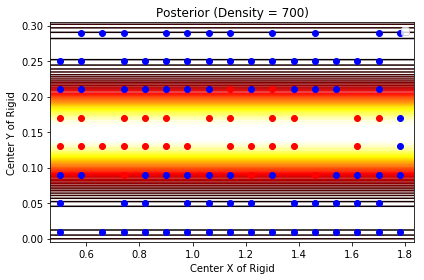

In [137]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

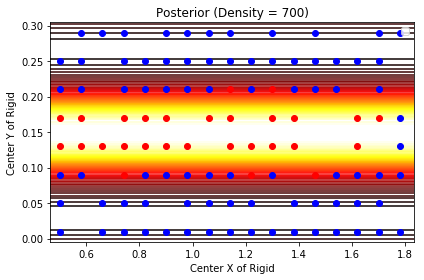

In [138]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

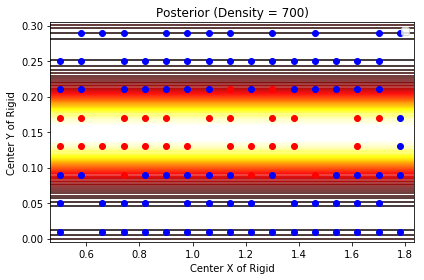

In [139]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

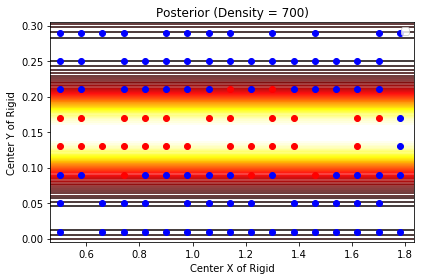

In [140]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

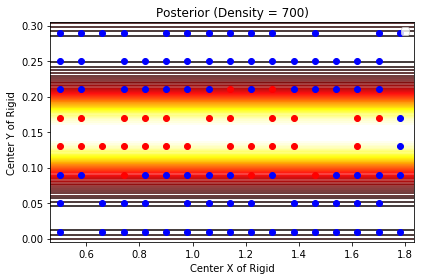

In [141]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

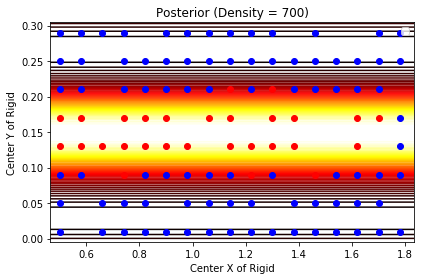

In [142]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

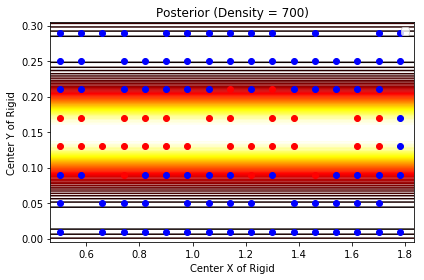

In [143]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

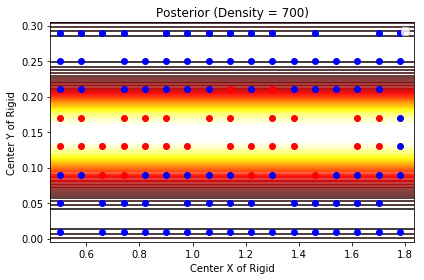

In [144]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

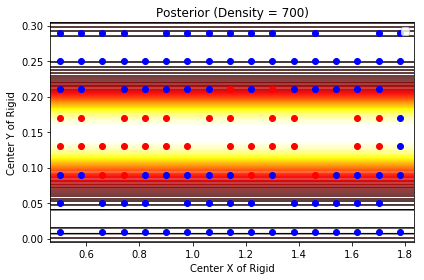

In [145]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

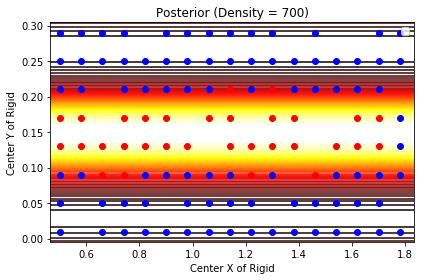

In [146]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

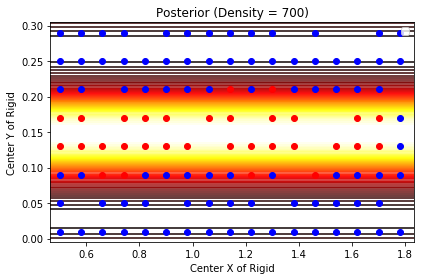

In [147]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

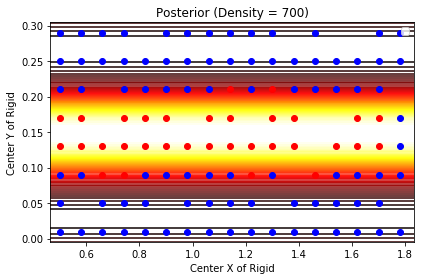

In [148]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

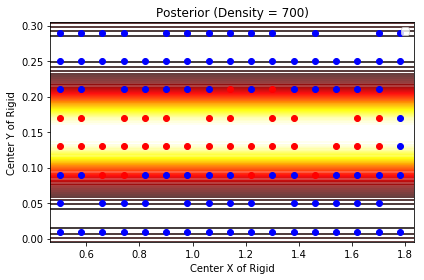

In [149]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

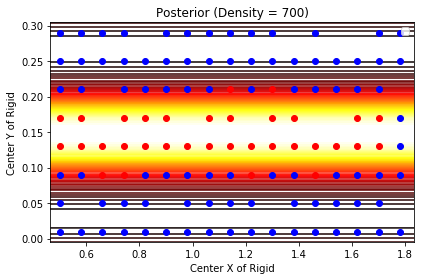

In [150]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

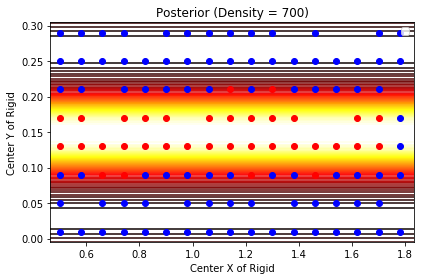

In [151]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,0)
i=i+1

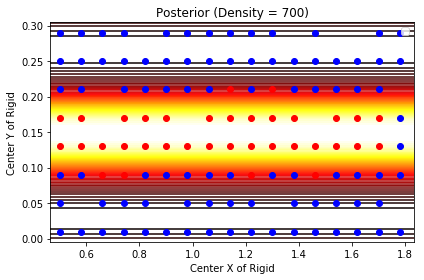

In [153]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,i)
i=i+1

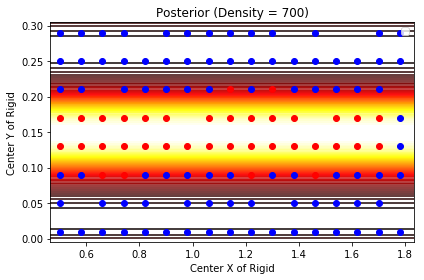

In [154]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,i)
i=i+1

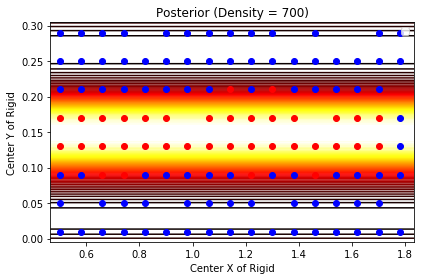

In [155]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,i)
i=i+1

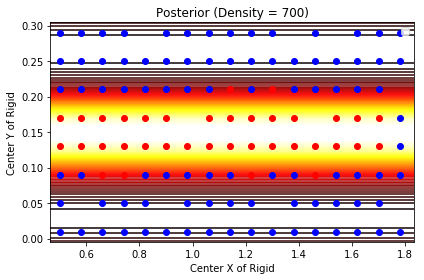

In [156]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,i)
i=i+1

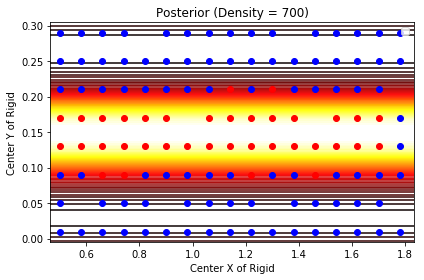

In [157]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,i)
i=i+1

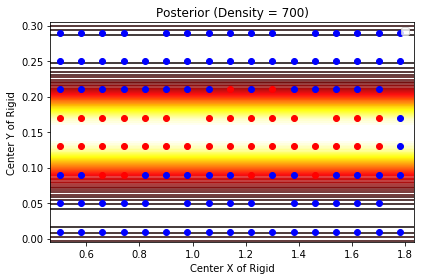

In [158]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,i)
i=i+1

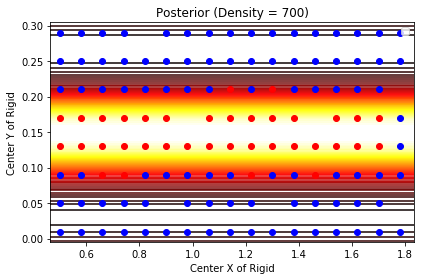

In [159]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,i)
i=i+1

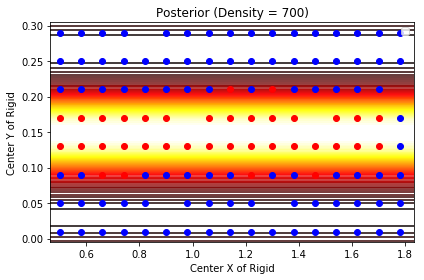

In [160]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,i)
i=i+1

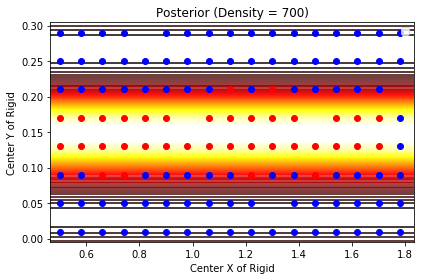

In [161]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,i)
i=i+1

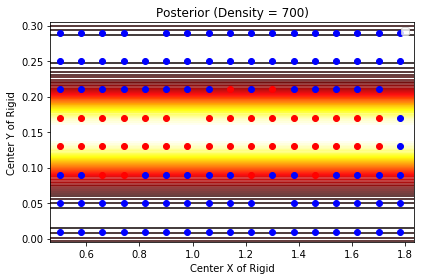

In [162]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,i)
i=i+1

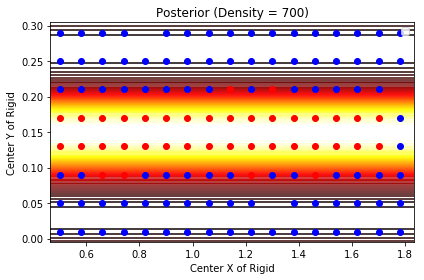

In [163]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,i)
i=i+1

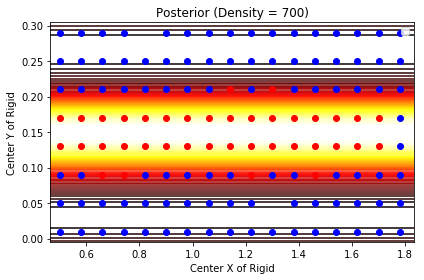

In [164]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,i)
i=i+1

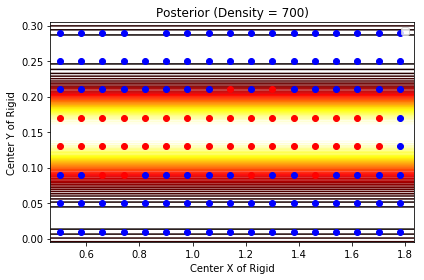

In [165]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,i)
i=i+1

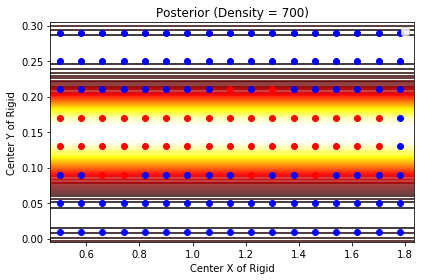

In [166]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,i)
i=i+1

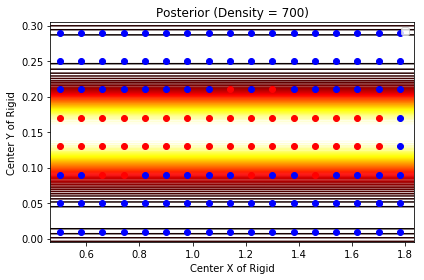

In [167]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,i)
i=i+1

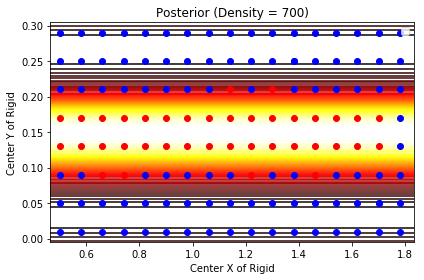

In [168]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,i)
i=i+1

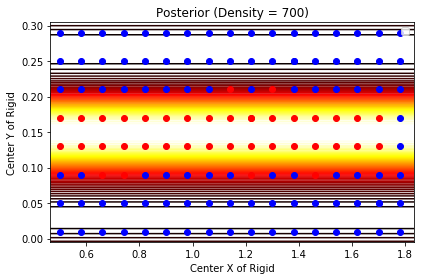

In [169]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,i)
i=i+1

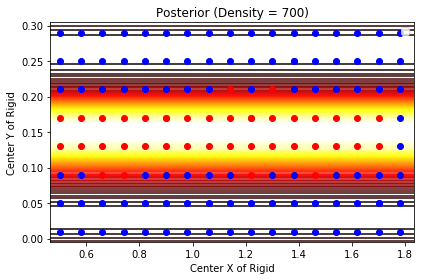

In [170]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,i)
i=i+1

ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5


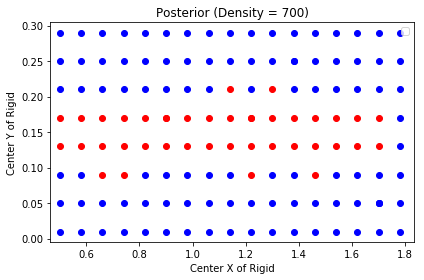

In [171]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,i)
i=i+1

ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5
ちょうど0.5


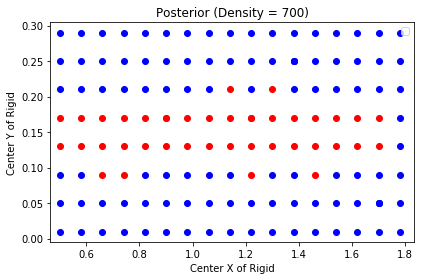

In [172]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,i)
i=i+1

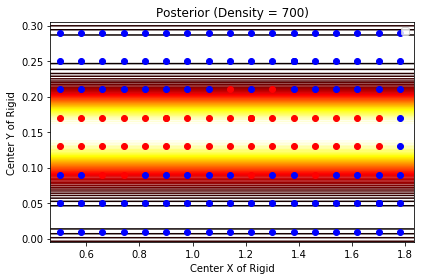

In [173]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,i)
i=i+1

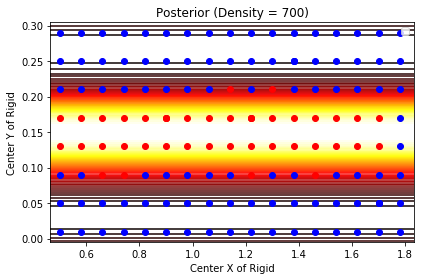

In [174]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,i)
i=i+1

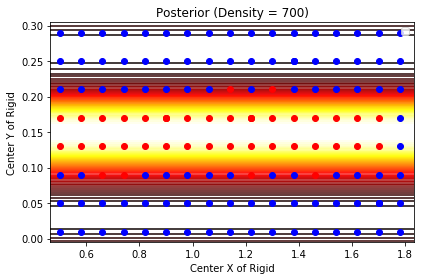

In [175]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,i)
i=i+1

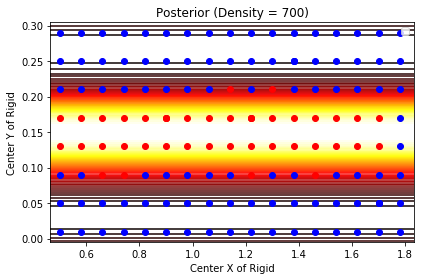

In [176]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,i)
i=i+1

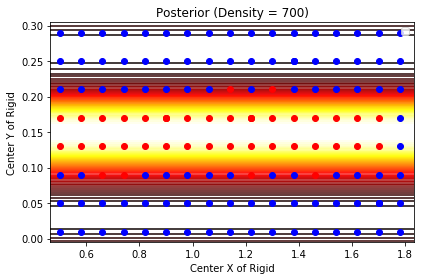

In [178]:
df_smpl = df_train.iloc[chk[0:10+i],:].reset_index(drop=True)
kernel = GPy.kern.Matern32(2, ARD=True)
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model,i)
i=i+1

In [179]:
i

138

In [ ]:
# 図製作作業

In [ ]:
df_train.shape

In [ ]:
df_train, df_test = train_test(df_700)
kernel = GPy.kern.Matern52(2, ARD=True)#+GPy.kern.White(2)
#kernel = GPy.kern.RBF(2, ARD=True)#+GPy.kern.White(2)

d = df_train
model = GPy.models.GPClassification(d[['x', 'y']].values, d.isCollide[:, None],kernel=kernel)
model.optimize(messages=True)

ax = model.plot(plot_data=False)
d0 = d[d.isCollide == 0]
d1 = d[d.isCollide == 1]
ax.plot(d0.x, d0.y, 'bo')
ax.plot(d1.x, d1.y, 'ro')
ax.set_title('Posterior (Density = 700)')
ax.set_xlabel("Center X of Rigid")
ax.set_ylabel("Center Y of Rigid")

In [ ]:
df_smpl = df_train
model = gp(df_smpl, kernel)
agg(df_test, model)
cnt_plt(df_smpl,model)

In [ ]:
# defalt : lower=2.5, upper=97.5 
ax = model.plot(fixed_inputs=[(0, 0.98)], plot_data=False,plot_raw=True,apply_link=True)
ax.set_title('X = 0.98')
ax.set_xlabel("Y")
ax.set_ylabel("Probability")
ax.set_xlim([0,0.3])
plt.axhline(y=0.5, lw=1, color='black')   #色や太さ、線種も設定できる

# 中点予測
#tt = pred_mean_train[pred_mean_train.x==0.98]
#plt.scatter(tt.y,tt['ave_mean'])

In [ ]:
kernel = GPy.kern.RBF(2, ARD=True)

d = pd.read_csv('http://kasugano.sakura.ne.jp/images/2016/20161112/data-classification.txt')
model = GPy.models.GPClassification(d[['X1', 'X2']].values, d.Y[:, None])
model.optimize()

ax = model.plot(plot_data=False)
d0 = d[d.Y == 0]
d1 = d[d.Y == 1]
ax.plot(d0.X1, d0.X2, 'ro')
ax.plot(d1.X1, d1.X2, 'bo')

# defalt : lower=2.5, upper=97.5 
ax = model.plot(fixed_inputs=[(0, 0)], plot_data=False,plot_raw=True,apply_link=True)
ax.set_title('X = 0')
ax.set_xlabel("Y")
ax.set_ylabel("Probability")
ax.set_xlim([-3,3])
plt.axhline(y=0.5, lw=1, color='black')   #色や太さ、線種も設定できる

Running L-BFGS-B (Scipy implementation) Code:
  runtime   i      f              |g|        
    00s08  0006   5.125647e+01   3.525187e+01 
    00s14  0015   4.717253e+01   2.043301e-02 
    00s19  0024   4.687745e+01   5.854617e-03 
    00s27  0042   4.686319e+01   4.648884e-11 
Runtime:     00s27
Optimization status: Converged



Text(0,0.5,'Center Y of Rigid')

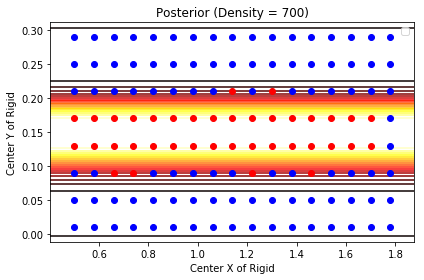

In [274]:
# 4all
kernel = GPy.kern.Matern32(2, ARD=True)#+GPy.kern.White(2)
df_train, df_test, = train_test(df_700)

d = df_train
model = GPy.models.GPClassification(d[['x', 'y']].values, d.isCollide[:, None],kernel=kernel)
model.optimize(messages=True)

ax = model.plot(plot_data=False)
d0 = d[d.isCollide == 0]
d1 = d[d.isCollide == 1]
ax.plot(d0.x, d0.y, 'bo')
ax.plot(d1.x, d1.y, 'ro')
ax.set_title('Posterior (Density = 700)')
ax.set_xlabel("Center X of Rigid")
ax.set_ylabel("Center Y of Rigid")

In [275]:
agg(df_test,model)

0.8571428571428571

Running L-BFGS-B (Scipy implementation) Code:
  runtime   i      f              |g|        
    00s19  0001   1.643646e+02   4.127631e+00 
    00s66  0056   7.686610e+01   2.563687e-11 
Runtime:     00s66
Optimization status: Converged



Text(0,0.5,'Center Y of Rigid')

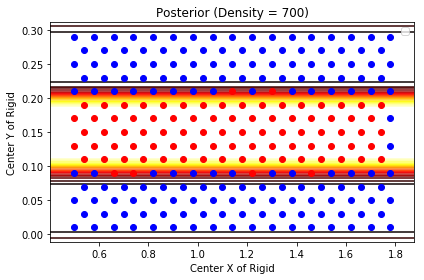

In [273]:
# 4all
kernel = GPy.kern.Matern52(2, ARD=True)#+GPy.kern.White(2)

d = df_700
model = GPy.models.GPClassification(d[['x', 'y']].values, d.isCollide[:, None],kernel=kernel)
model.optimize(messages=True)

ax = model.plot(plot_data=False)
d0 = d[d.isCollide == 0]
d1 = d[d.isCollide == 1]
ax.plot(d0.x, d0.y, 'bo')
ax.plot(d1.x, d1.y, 'ro')
ax.set_title('Posterior (Density = 700)')
ax.set_xlabel("Center X of Rigid")
ax.set_ylabel("Center Y of Rigid")

In [ ]:
agg(test,model)

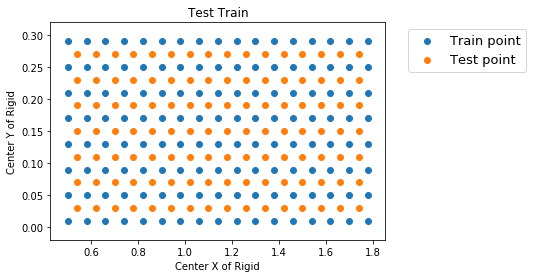

In [277]:
# train test point
df_train, df_test = train_test(df_700)
s1 = plt.scatter(df_train.x, df_train.y)
s2 = plt.scatter(df_test.x, df_test.y)
plt.title('Test Train')
plt.xlabel("Center X of Rigid")
plt.ylabel("Center Y of Rigid")
plt.legend((s1,s2),('Train point', 'Test point'),bbox_to_anchor=(1.05, 1),loc='upper left',fontsize=13)

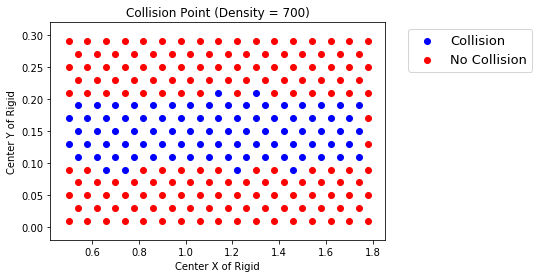

In [276]:
# ans point
d = df_700
d1 = d[d.isCollide == 0]
d0 = d[d.isCollide == 1]
s1 = plt.scatter(d1.x, d1.y, c='Red')
s2 = plt.scatter(d0.x, d0.y, c='Blue')
plt.title('Collision Point (Density = 700)')
plt.xlabel("Center X of Rigid")
plt.ylabel("Center Y of Rigid")
plt.legend((s2,s1),('Collision', 'No Collision'),bbox_to_anchor=(1.05, 1),loc='upper left',fontsize=13)
plt.savefig('./ClsPint.png')

In [ ]:
8*16